In [34]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec
import datetime
import re
import json
import sys
from elasticsearch import Elasticsearch, exceptions as es_exceptions
from elasticsearch.helpers import scan

es = Elasticsearch(hosts=[{'host':'atlas-kibana.mwt2.org', 'port':9200}],timeout=60)

myquery = {
  "size": 10000,
  "query": {
    "bool": {
      "must": [
        {
          "query_string": {
            "query": "jobmetrics:scout*ramCount",
            "analyze_wildcard": True,
            "lowercase_expanded_terms": False
          }
        },
        {                
          "range": {
            "modificationtime": {
              "gte": "20161219T100708.000Z",
              "lte": "20161221T100808.000Z",
              "format": "basic_date_time"
            }
          }
        }    
      ]
    }
  }
}

res = es.search(index='jobs_archive_2016-12-*', body=myquery, request_timeout=600)

print(res['hits']['hits'])


[{'_index': 'jobs_archive_2016-12-19', '_id': '3131516107', '_type': 'jobs_data', '_score': 2.0, '_source': {'corecount': 1, 'starttime': '2016-12-19T10:20:50', 'taskbuffererrordiag': None, 'brokerageerrorcode': 0, 'maxcpucount': 0, 'ddmerrordiag': None, 'inputfileproject': 'data16_13TeV:data16_13TeV', 'cloud': 'UK', 'avgrss': 343552, 'currentpriority': -1117, 'cpuconsumptionunit': 's+Intel(R) Xeon(R) CPU E5-2650 v2 @ 2.60GHz 20480 KB', 'exeerrordiag': None, 'timeStageIn': 36, 'transformation': 'http://pandaserver.cern.ch:25085/trf/user/runGen-00-00-02', 'specialhandling': 'ddm:rucio', 'taskid': 21, 'proddblock': 'data16_13TeV:data16_13TeV.00311402.physics_Main.merge.DAOD_SUSY7.f758_m1710_p2880_tid09980931_00', 'timeStageOut': 38, 'maxattempt': 3, 'superrorcode': 0, 'avgswap': 0, 'modificationhost': 'slot1_14@lcg1715.gridpp.rl.ac.uk', 'endtime': '2016-12-19T10:24:39', 'timeExe': 103, 'brokerageerrordiag': None, 'maxrss': 652664, 'jobsubstatus': None, 'prodserieslabel': 'pandatest', 'cm

In [35]:
datx=[]
print("Numero de entradas:", len(res['hits']['hits']))
for i in range(len(res['hits']['hits'])):
    print(res['hits']['hits'][i]['_source']['maxpss'])
    datx.append(res['hits']['hits'][i]['_source']['maxpss'])

Numero de entradas: 6836
642880
7184849
553528
632866
8925491
853021
479966
681995
627712
1557891
6707
617159
79515
628132
556077
475130
463121
1233617
623772
460446
484552
981633
479517
480350
583333
1818136
572061
746665
653780
601663
590385
607091
578997
538660
469065
10505
582321
586402
558684
596479
634234
587910
469042
493339
717946
605887
21023
576620
593142
566083
758533
398160
488400
487069
12224
480191
616945
622210
803474
480237
540751
742380
547260
592420
573370
574264
589286
596845
703957
595501
526643
831352
541431
595653
587726
541379
638571
14202
641257
876437
670125
670825
762947
781933
588205
537966
8586
635230
358626
16661
789069
674271
741054
603707
13536779
614789
1452540
3284691
492940
483518
3073941
3744537
283936
549743
309435
483141
10328654
610345
1194467
8985761
1145981
2827191
2771485
9146885
528895
620677
482492
9591396
3770681
768900
580726
768342
994558
1198062
484286
476024
38897
751768
599560
484091
187362
3788830
339
3057774
3119522
1861062
823738
6477

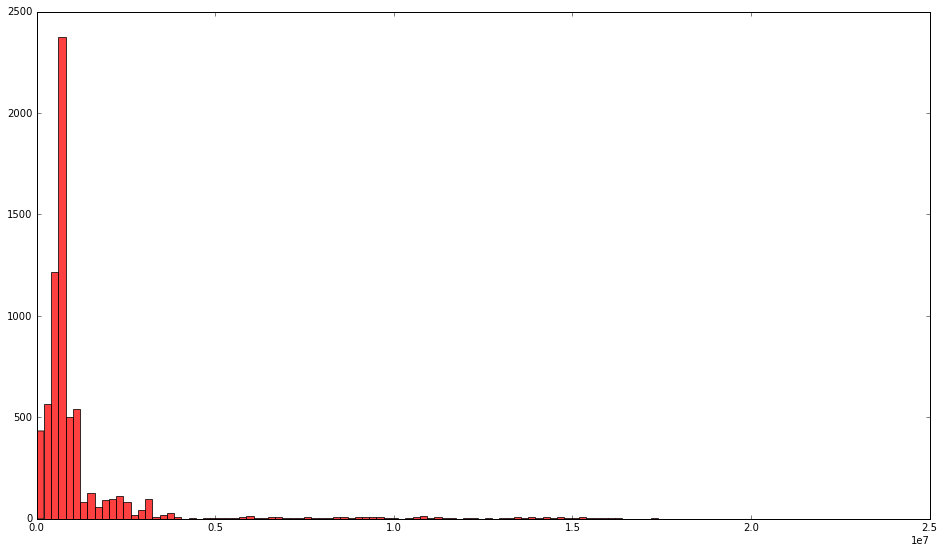

In [36]:
plt.figure(figsize=[16, 20])
gs = gridspec.GridSpec(2, 1)
ax0 = plt.subplot(gs[0])
ax0.hist(datx, 100, normed=0, facecolor='red', alpha=0.75)
plt.savefig('maxpss.jpg', dpi=300)
plt.show()